# Accessibility for London's public transport network

![TFL MAP](https://tfl.gov.uk/cdn/static/cms/images/london-rail-and-tube-services-map.gif)

## Introduction

### 1.1 Background

London's complex public transportation system serves millions of passengers daily and includes a wide range of bus routes and underground stations. However, accessibility remains a critical concern, especially for individuals with mobility impairments. To evaluate the inclusiveness of this network, we propose using an agent-based model to assess the accessibility of public transport in London, with a specific focus on **step-free access**.

As an initial step, we merge the bus stop location dataset with the tube station location dataset, appending two new columns to record the names of all bus and tube stops within a 0.5-mile radius for each station. Following this spatial augmentation, we incorporate footfall data to assign weightings to each station based on passenger volume. We then utilize Monte Carlo simulations to model popular travel routes across the network.

Under the constraint of considering **only step-free stations**, we preliminarily evaluate whether a given origin-destination (OD) pair has a feasible route. Routes are labeled as "1" if a step-free path exists, and the number of interchanges is recorded; otherwise, they are labeled as "0." For all accessible OD pairs (label = 1), we apply shortest path algorithms to compute minimal distance or travel time, allowing us to identify routes that, while accessible, are inefficient compared to the average.

Our final analysis targets two categories of concern: (1) **inaccessible OD pairs** (label = 0), and (2) **inefficient but accessible routes** (label = 1 with high cost). We trace these routes to identify critical interruption points and evaluate their frequency and crowd density. These stations are then prioritized for potential infrastructure upgrades, such as new bus stop installations or transfer improvements.

### 1.2 Research Questions

- How accessible is London’s public transport system for mobility-impaired passengers, considering only step-free routes?
- Can we identify high-demand routes that are either inaccessible or significantly inefficient for step-free travel?
- What are the key transfer stations or segments that contribute to poor accessibility, and how can infrastructure investment be prioritized accordingly?

### 1.3 Data Sources

**1.3.1 Footfall Data**  
- Source:  
  https://app.powerbi.com/view?r=eyJrIjoiMjZjMmQwYTktZjYxNS00MTIwLTg0ZjAtNWIwNGE0ODMzZGJhIiwidCI6IjFmYmQ2NWJmLTVkZWYtNGVlYS1hNjkyLWEwODljMjU1MzQ2YiIsImMiOjh9
  or https://crowding.data.tfl.gov.uk/Network%20Demand/StationFootfall_2023_2024%20.csv  
- Description: Historical station-level passenger flow data from the London Underground (TfL)

**1.3.2 Station Location Data**  
- Bus Stop Locations: https://data.london.gov.uk/dataset/tfl-bus-stop-locations-and-routes 
- Tube Station Locations: https://foi.tfl.gov.uk/FOI-2209-2122/Station%20locations.csv  

**1.3.3 Accessibility Data**  
- Step-free Access Information: https://content.tfl.gov.uk/step-free-tube-guide-map.pdf  
- Note: Additional data sources will be explored to supplement this guide and ensure comprehensive coverage of accessibility infrastructure.
e：


In [1]:
# import necessary libraries
import numpy as np
import pandas as pd  

## Data processing
### 2.1Tube Data preprocessing and Data Extraction

In [21]:
import os
import pandas as pd

file_paths = [
    "C:/Users/46842/OneDrive/Desktop/tfl_data/StationFootfall_2019.csv",
    "C:/Users/46842/OneDrive/Desktop/tfl_data/StationFootfall_2020.csv",
    "C:/Users/46842/OneDrive/Desktop/tfl_data/StationFootfall_2021.csv",
    "C:/Users/46842/OneDrive/Desktop/tfl_data/StationFootfall_2022.csv",
    "C:/Users/46842/OneDrive/Desktop/tfl_data/StationFootfall_2023_2024 .csv"
]

tfl_list = []

for file_path in file_paths:
    df = pd.read_csv(file_path, header=0)
    print(df.columns)
    tfl_list.append(df)

Index(['TravelDate', 'DayOFWeek', 'Station', 'EntryTapCount', 'ExitTapCount'], dtype='object')
Index(['TravelDate', 'DayOFWeek', 'Station', 'EntryTapCount', 'ExitTapCount'], dtype='object')
Index(['TravelDate', 'DayOFWeek', 'Station', 'EntryTapCount', 'ExitTapCount'], dtype='object')
Index(['TravelDate', 'DayOFWeek', 'Station', 'EntryTapCount', 'ExitTapCount'], dtype='object')
Index(['TravelDate', 'DayOfWeek', 'Station', 'EntryTapCount', 'ExitTapCount'], dtype='object')


### 2.2 Webcraping  
The following code block is used to get the station location of the metro. It will need to create an .env file with APP_KEY in the same directory as this script.APP_KEY is the api key for the TfL API. See https://api-portal.tfl.gov.uk/ for more information.
The site location includes latitude and longitude using the WGS84 coordinate system. The location of the stations and other information is saved in a csv file named stations_location.csv in the data folder for further use.

In [22]:
APP_ID= "crowding"
APP_KEY = "0a2ad06e04f243b2a3a0cdbf8c62e314"

In [3]:
import os
import requests
import pandas as pd
import csv
from dotenv import load_dotenv

load_dotenv()
APP_ID = os.getenv("APP_ID")
APP_KEY = os.getenv("APP_KEY")

def get_line_ids() -> dict[str, tuple[str, str]]:
    """
    Gets the routing information for all lines and filters out the tube, dlr, overground and elizabeth-line modes.
    Returns a dictionary with line id as key and (line name, mode name) as value.
    """
    url_line = "https://api.tfl.gov.uk/Line/Route"
    params = {
        "app_id": APP_ID,
        "app_key": APP_KEY,
    }
    response = requests.get(url_line, params=params)
    response.raise_for_status()  
    data = response.json()

    mode_interested = ["tube", "dlr", "overground", "elizabeth-line"]
    line_ids = {}
    for line in data:
        if line.get("modeName") in mode_interested:
            line_ids[line["id"]] = (line["name"], line["modeName"])
    return line_ids

def get_station_stop_points(line_id: str) -> list[dict]:
    """
    Get all stations on a line by line id.
    :param line_id: line id
    :return: list of stations
    """
    url_stop_points = f"https://api.tfl.gov.uk/Line/{line_id}/StopPoints"
    params = {
        "app_id": APP_ID,
        "app_key": APP_KEY,
    }
    response = requests.get(url_stop_points, params=params)
    response.raise_for_status()
    return response.json()

def get_station_stop_points_df() -> pd.DataFrame:
    """
    Get the information of all the stations under the line of interest and construct a DataFrame.
    """
    lines = get_line_ids()
    stop_points_all = []
    
    for line_id, (line_name, mode_name) in lines.items():
        try:
            stop_points = get_station_stop_points(line_id)
            for sp in stop_points:
                stop_points_all.append({
                    "line_id": line_id,
                    "line_name": line_name,
                    "mode_name": mode_name,
                    "station_id": sp.get("id", ""),
                    "station_name": sp.get("commonName", ""),
                    "lat": sp.get("lat", ""),
                    "lon": sp.get("lon", ""),
                    "station_modes": sp.get("modes", []),
                })
        except requests.RequestException as e:
            print(f"Failed to get station information for line {line_id}: {e}")
    
    return pd.DataFrame(stop_points_all)

def save_station_locations(file_path: str = "data/stations_location.csv") -> None:
    """
    Get station location information and save it to a CSV file
    """
    os.makedirs(os.path.dirname(file_path), exist_ok=True)
    
    df = get_station_stop_points_df()
    df.to_csv(file_path, index=False, encoding="utf-8")
    print(f"Metro station location information has been saved to {file_path}")

if __name__ == "__main__":
    try:
        save_station_locations()
    except Exception as e:
        print("Error during programme execution：", e)


Metro station location information has been saved to data/stations_location.csv


The following code block matches the station names in the TfL data with the station names in the location data. Matched data are saved in tfl_stations_location.csv for further use.

In [9]:
tfl_df = pd.concat(tfl_list, ignore_index=True)

# Pre-processing of station names for subsequent matching: removal of spaces, conversion to lower case
tfl_df["Station_clean"] = tfl_df["Station"].astype(str).str.strip().str.lower()

location_file = "data/stations_location.csv"
location_df = pd.read_csv(location_file)

# The station names in the location data are also preprocessed
location_df["station_name_clean"] = location_df["station_name"].astype(str).str.strip().str.lower()

# Merge based on preprocessed columns
merged_df = pd.merge(
    tfl_df,
    location_df,
    left_on="Station_clean",
    right_on="station_name_clean",
    how="inner"
)

output_file = "data/tfl_stations_location.csv"
merged_df.to_csv(output_file, index=False, encoding="utf-8")
print(f"The matched data has been saved to the {output_file}")

The matched data has been saved to the data/tfl_stations_location.csv


The following code block merges the metro station names from the TfL data with the station names from the bus data. The matched data will be saved in merged_stations.csv for further use.

In [13]:
print(merged_df.columns) # For checking the next block: which columns are in merged_df

Index(['commonName', 'lat_bus', 'lon_bus', 'is_pure_bus', 'id', 'lines',
       'name_clean', 'line_id', 'line_name', 'mode_name', 'station_id',
       'station_name', 'lat_station', 'lon_station', 'station_modes'],
      dtype='object')


In [23]:
import pandas as pd

# read
bus_df = pd.read_csv("processed_bus_stops.csv")
station_df = pd.read_csv("data/stations_location.csv")

# clean
bus_df["name_clean"] = bus_df["commonName"].str.strip().str.lower()
station_df["name_clean"] = station_df["station_name"].str.strip().str.lower()

# merge data
merged_df = pd.merge(
    bus_df,
    station_df,
    on="name_clean",
    how="outer",
    suffixes=('_bus', '_station')
)

# Prioritise the use of bus data and supplement with metro data if missing
merged_df['station_name'] = merged_df['commonName'].combine_first(merged_df['station_name'])
merged_df['latitude'] = merged_df['lat_bus'].combine_first(merged_df['lat_station'])            # 公交：lat，地铁：y
merged_df['longitude'] = merged_df['lon_bus'].combine_first(merged_df['lat_station'])           # 公交：lon，地铁：x
merged_df['station_id'] = merged_df['id'].combine_first(merged_df['station_id'])    # 公交：id，地铁：OBJECTID

# Merge the line field and fill in the null value as ‘unknown’
merged_df['lines'] = merged_df['lines'].combine_first(merged_df['line_id'])
merged_df['lines'] = merged_df['lines'].fillna('unknown')

# Merge the site type field and fill in the blanks for ‘bus’
merged_df['mode'] = merged_df['mode_name'].fillna('bus')

# Extract final fields and de-weight them
final_df = merged_df[['station_name', 'latitude', 'longitude', 'mode', 'lines', 'station_id']].drop_duplicates()

final_df.to_csv("data/merged_stations.csv", index=False, encoding="utf-8")

print("Data have been merged and saved to merged_stations.csv")


Data have been merged and saved to merged_stations.csv


Add two more columns to the dataset merged_stations.csv for the names of the bus and underground stops within 0.5 miles (great circle distance) of each station.

In [24]:
import pandas as pd
from scipy.spatial import KDTree
import numpy as np

df = pd.read_csv("data/merged_stations.csv")

# Latitude and longitude converted to radians and then converted to approximate plane coordinates, 1 degree ≈ 69 miles.
df = df.dropna(subset=["latitude", "longitude"])
df["x"] = df["longitude"] * 69.0
df["y"] = df["latitude"] * 69.0

# Building a KDTree to Accelerate Spatial Search
coords = df[["x", "y"]].values
tree = KDTree(coords)

# Query neighbours within 0.5 miles of each point
neighbors_list = []
for i, point in enumerate(coords):
    indices = tree.query_ball_point(point, r=0.5)
    indices = [j for j in indices if j != i]  # remove oneself
    neighbor_names = df.iloc[indices]["station_name"].tolist()
    neighbors_list.append(", ".join(sorted(set(neighbor_names))))

df["nearby_stations_0.5mile"] = neighbors_list

df.drop(columns=["x", "y"]).to_csv("data/stations_with_neighbors.csv", index=False, encoding="utf-8")
print("Neighbourhood site search completed and saved as stations_with_neighbors.csv")


Neighbourhood site search completed and saved as stations_with_neighbors.csv


The following code is to draw two charts separately:

Figure 1: Histogram of the Distribution of the Number of Neighbouring Sites
This graph shows the distribution of the number of neighbouring stations within a 0.5 mile radius of each station.
It can be seen that most stations have between 10 and 20 neighbours, indicating that most areas of London have a dense public transport network. At the same time there are isolated stations or transport hubs that have fewer or more neighbouring stations respectively.

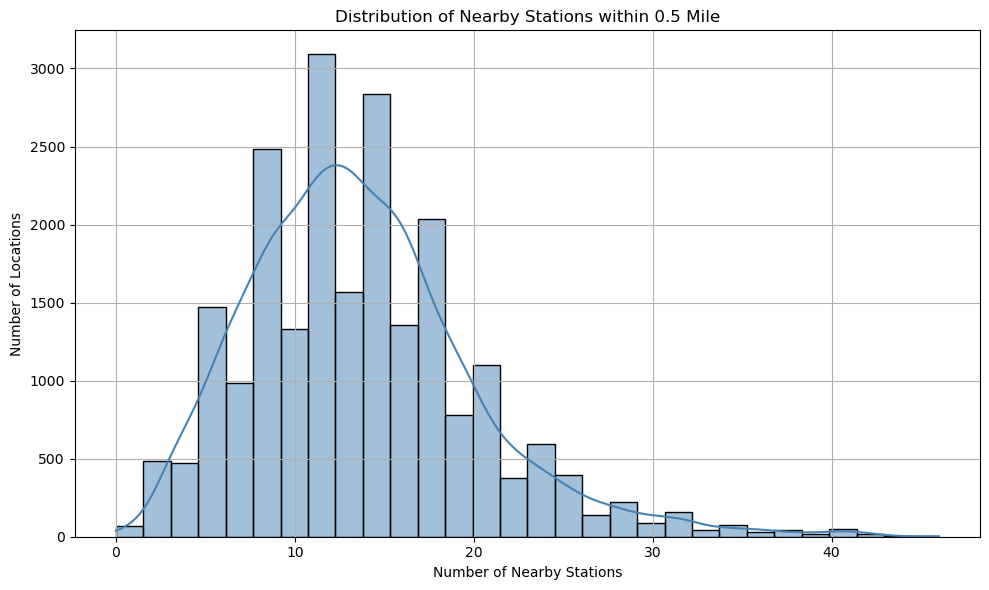

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("data/stations_with_neighbors.csv")

# Calculate the number of neighbouring stations
df["num_nearby_stations"] = df["nearby_stations_0.5mile"].fillna("").apply(lambda x: len(x.split(", ")) if x else 0)

# Plotting histograms
plt.figure(figsize=(10, 6))
sns.histplot(df["num_nearby_stations"], bins=30, kde=True, color='steelblue')
plt.title("Distribution of Nearby Stations within 0.5 Mile")
plt.xlabel("Number of Nearby Stations")
plt.ylabel("Number of Locations")
plt.grid(True)
plt.tight_layout()
plt.show()

Figure 2: Spatial heat map of neighbourhood density (Heatmap)

This figure visualises the spatial distribution of site density in the form of a geographic heat map. Brighter colours indicate more neighbours within 0.5 miles of the site, reflecting a denser transport network. The central London area can be clearly identified as a high density area of the transport network, while the outer areas are relatively sparse. This map is useful for subsequent identification of blind spots in the network and optimisation of resource allocation.

In [28]:
import folium
from folium.plugins import HeatMap
import pandas as pd

df = pd.read_csv("data/stations_with_neighbors.csv")

df = df.dropna(subset=["latitude", "longitude"])
df["num_nearby_stations"] = df["nearby_stations_0.5mile"].fillna("").apply(lambda x: len(x.split(", ")) if x else 0)

m = folium.Map(location=[51.5074, -0.1278], zoom_start=11)

heat_data = df[["latitude", "longitude", "num_nearby_stations"]].values.tolist()
HeatMap(heat_data, radius=12, max_zoom=13).add_to(m)
m
# m.save("data/london_station_heatmap.html")

# Exploration of NUMBAT data

The main data (NUMBAT dataset for 2023) for this analysis comes from statistics on usage and travel patterns on TfL railway services provided by Transport for London, which can be accessed through https://crowding.data.tfl.gov.uk/.

Five datasets were used in this analysis: NBT23FRI_outputs.xlsx, NBT23MON_outputs.xlsx, NBT23SAT_outputs.xlsx, NBT23SUN_outputs.xlsx, NBT23TWT_outputs.xlsx. Each dataset corresponds to a typical autumn day of the week. TWT represents Tuesday, Wednesday, and Thursday.

Each dataset contains eight sheets, namely: Link_Loads, Link_Frequencies, Link_Boarders, Station_Flows, Station_Entries, Station_Exits, Station_boarders, Station_Alighters. Our analysis focuses on the five sheets "Link_Loads", "Link_Frequencies", "Station_Flows", "Station_Entries", "Station_Exits".

Link_Loads: The demand between two stations.
Link_Frequencies: The frequency of trains between two stations.
Station_Flows: The number of passengers entering, exiting, and transferring at each station.
Station_Entries: The number of passengers entering each station.
Station_Exits: The number of passengers exiting each station.
The data is recorded every 15 minutes.

In [2]:
# import necessary libraries
import os
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import dotenv
import requests
import folium
import branca
from folium.plugins import HeatMap
from IPython.display import display, HTML
from ipywidgets import interact
from tqdm.notebook import tqdm
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

### 3.1 Data import and preprocessing

Due to the large amount of data, only specific sheets ("Link_Loads", "Link_Frequencies", "Station_Flows", "Station_Entries", "Station_Exits") of each dataset were selected after considering the specific research questions.

In [3]:
file_paths = [
    "data/NBT23MON_outputs.xlsx",
    "data/NBT23TWT_outputs.xlsx",
    "data/NBT23FRI_outputs.xlsx",
    "data/NBT23SAT_outputs.xlsx",
    "data/NBT23SUN_outputs.xlsx"
]

sheet_names = [
    "Link_Loads",
    "Link_Frequencies",
    "Station_Flows",
    "Station_Entries",
    "Station_Exits"
]

data_frames = {}

for file_path in file_paths:
    data_frames[file_path] = {}
    for sheet in sheet_names:
        df = pd.read_excel(file_path, sheet_name=sheet, skiprows=2)
        data_frames[file_path][sheet] = df

#Adjust all numbers in all datafrmaes to round to integers
for file_path in data_frames:
    for sheet in data_frames[file_path]:
        data_frames[file_path][sheet] = data_frames[file_path][sheet].map(
            lambda x: round(x) if isinstance(x, (float, int)) else x)

In [4]:
all_station_flows = pd.DataFrame()

for file_path, sheets in data_frames.items():
    station_flows = sheets["Station_Flows"]
    #"Alight-Interchange-Board", "Alight-Exit-Interchange-Enter-Board" are classified as "interchange"
    station_flows["New movement"] = station_flows["Movement"].apply(
        lambda x: "Interchange" if "Interchange" in x else x
    )
    
    grouped_data = (
        station_flows.groupby(["From Station", "New movement"])["Total"]
        .sum()
        .reset_index()
    )
    # aggregate MON,TWT,FRI,SAT,SUN
    if all_station_flows.empty:
        all_station_flows = grouped_data
    else:
        all_station_flows = all_station_flows.merge(
            grouped_data,
            on=["From Station", "New movement"],
            how="outer",
            suffixes=("", "_new"),
        )
        all_station_flows["Total"] = all_station_flows["Total"] + all_station_flows["Total_new"]
        all_station_flows = all_station_flows.drop(columns=["Total_new"])
all_station_flows.head()

,From Station,New movement,Total
0,Abbey Road,Alight-Exit,9509
1,Abbey Road,Enter-Board,9452
2,Abbey Wood,Alight-Exit,110347
3,Abbey Wood,Enter-Board,94284
4,Abbey Wood,Interchange,25883


In [5]:
print(all_station_flows[all_station_flows["New movement"] == "Alight-Exit"].sort_values(by='Total', ascending=False).iloc[0])
print(all_station_flows[all_station_flows["New movement"] == "Interchange"].sort_values(by='Total', ascending=False).iloc[0])
print(all_station_flows[all_station_flows["New movement"] == "Enter-Board"].sort_values(by='Total', ascending=False).iloc[0])

From Station    London Bridge NR
New movement         Alight-Exit
Total                     560812
Name: 613, dtype: object
From Station      Stratford
New movement    Interchange
Total                681207
Name: 917, dtype: object
From Station    King's Cross St. Pancras
New movement                 Enter-Board
Total                             526625
Name: 561, dtype: object


Here we output the highest passenger flow of entries, exists and interchange. The station with the highest entry passenger flow is King’s Cross St (526625). Pancras. The station with the highest eixt passenger flow is London Bridge NR (560812). The station with the most transfer flow is Stratford (681207), reflecting its status as an important transportation hub. These stations bear significant passenger pressure due to their strategic locations and complex transit networks.

Text(0.5, 0.98, 'Histogram of Total Flows')

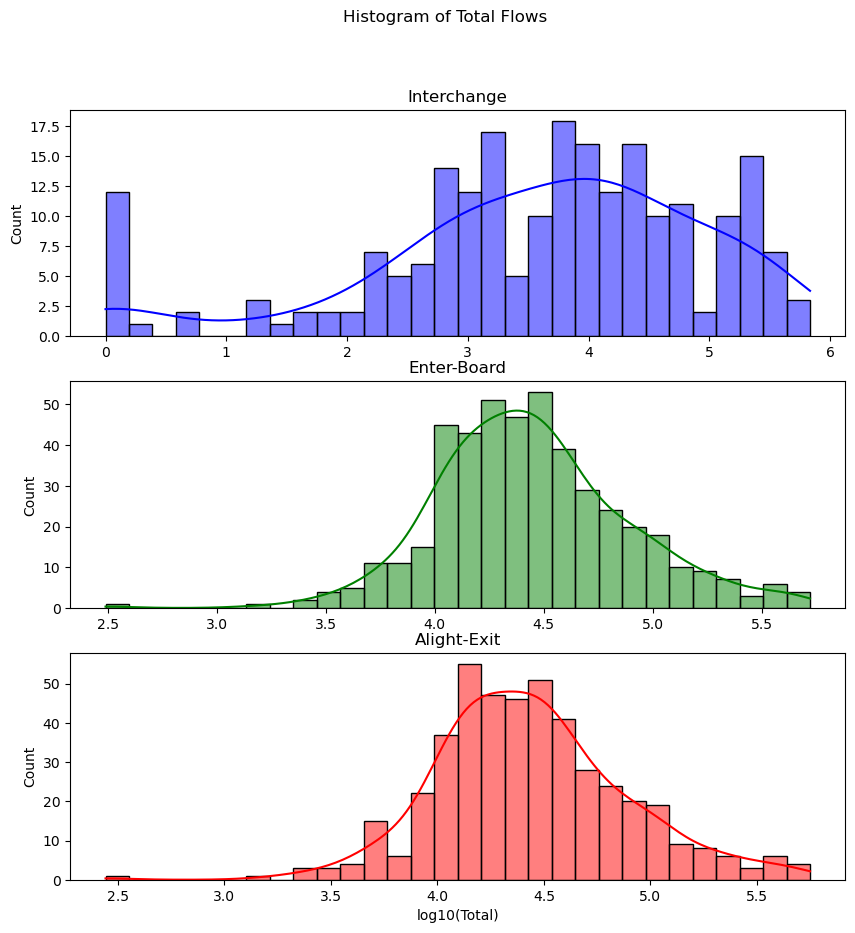

In [6]:
all_station_flows["log_Total"] = np.log10(all_station_flows["Total"] + 1)

fig, ax = plt.subplots(3, 1, figsize=(10, 10))
sns.histplot(
    all_station_flows[all_station_flows["New movement"] == "Interchange"],
    x="log_Total",
    bins=30,
    kde=True,
    ax=ax[0],
    color="blue"
)
sns.histplot(
    all_station_flows[all_station_flows["New movement"] == "Enter-Board"],
    x="log_Total",
    bins=30,
    kde=True,
    ax=ax[1],
    color="green"
)
sns.histplot(
    all_station_flows[all_station_flows["New movement"] == "Alight-Exit"],
    x="log_Total",
    bins=30,
    kde=True,
    ax=ax[2],
    color="red"
)

ax[0].set_title("Interchange")
ax[1].set_title("Enter-Board")
ax[2].set_title("Alight-Exit")
ax[0].set_xlabel("")
ax[1].set_xlabel("")
ax[2].set_xlabel("log10(Total)")

plt.suptitle("Histogram of Total Flows")

The above figure shows the log transformed histogram of total entries, exits and interchanges for each station. The histogram of entries and exits looks like a bell curve while the histogram of interchange shows the log total peaks at 0, around 3, 4 and between 5 and 6.

In [52]:
all_station_flows.groupby("New movement")["Total"].describe()

,count,mean,std,min,25%,50%,75%,max
New movement,,,,,,,,
Alight-Exit,459.0,49078.782135,73706.098405,276.0,14146.50,25508.0,48782.00,560812.0
Enter-Board,458.0,48857.932314,70782.873196,308.0,14541.75,25878.0,47751.75,526625.0
Interchange,221.0,50813.475113,104634.089995,0.0,786.00,6633.0,35493.00,681207.0


From the description of movement data, we can see that 
- The mean of entries, exits and interchange is 49078, 48857, 50813, respectively. They are very close to each other. However, they are much larger than their median, which are 25508, 25979, 6633, respectively. The median of interchange is much smaller than the median of entries and exits.
- This indicates that most of the stations have a small number of entries, exits and interchanges while a few stations have a very large number of entries, exits and interchanges.

In [60]:
station_locations = pd.read_csv("data/tfl_stations_location.csv")

location_data = pd.merge(
    all_station_flows,
    station_locations,
    left_on="From Station",
    right_on="Station",
    how="inner"
)

def station_heatmap(data, movement_category):
    category_data = data[data["New movement"] == movement_category]
    station_map = folium.Map(location=[51.5074, -0.1278], zoom_start=11,width="400px", height="300px")
  
    max_total = category_data["Total"].max()
    min_total = category_data["Total"].min()
    range_total = max_total - min_total if max_total != min_total else 1
    
    colormap = branca.colormap.LinearColormap(colors=["lightyellow", "orange", "red"], vmin=min_total, vmax=max_total)
    colormap.caption = f"{movement_category} Flow Intensity"
    
    for _, row in category_data.iterrows():
        intensity = (row["Total"] - min_total) / range_total
        color = colormap(row["Total"])
        
        folium.CircleMarker(
            location=(row["lat"], row["lon"]),
            radius=5 + 10 * intensity,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.8,
            tooltip=f"{row['From Station']} - {row['Total']}"
        ).add_to(station_map)
    
    colormap.add_to(station_map)
    station_map.get_root().width = "370px"
    station_map.get_root().height = "300px"
    return station_map

def display_maps(maps, titles):
    map_htmls = [
        f"""
        <div style="text-align: center; margin: 10px;">
            <h4>{title}</h4>
            {map_object._repr_html_()}
        </div>
        """
        for map_object, title in zip(maps, titles)
    ]
    combined_html = """
    <div style="display: flex; justify-content: space-around; align-items: flex-start;">
        {}
    </div>
    """.format("".join(map_htmls))
    display(HTML(combined_html))

alight_exit_map = station_heatmap(location_data, "Alight-Exit")
enter_board_map = station_heatmap(location_data, "Enter-Board")
interchange_map = station_heatmap(location_data, "Interchange")

titles = ["Alight-Exit Map", "Enter-Board Map", "Interchange Map"]

display_maps([alight_exit_map, enter_board_map, interchange_map], titles)

The maps above illustrate the spatial distribution of passenger flows across the London transport network for different movement types: Alight-Exit, Enter-Board, and Interchange. These interactive maps were generated using geographic data retrieved via APIs, combined with station flow statistics. Each circle on the map represents a station, with the size and color intensity indicating the passenger volume. Redder and larger circles signify higher passenger flows, while smaller, lighter circles represent lower traffic. These maps are interactive, allowing for dynamic exploration of the spatial data. People can zoom in to examine individual stations or zoom out for a broader view of traffic patterns. By overlaying geographic context with passenger flow data, these maps provide actionable insights into network usage and highlight areas requiring operational focus or infrastructure upgrades.

Alight-Exit Map: This map displays the stations with the highest exit flow. We can visually see the prominent circle stations, for example: London Bridge NR (560812), King's Cross St. Pancras (532659), Victoria NR (499111).
Enter-Board Map: This map visualizes entry flow intensity (King's Cross St. Pancras: 526625, London Bridge NR: 467863, Victoria NR: 457237).
Interchange Map: This map highlights stations with high interchange activity (Stradford: 681207, Oxford Circus: 583604). The stations with the largest in-and-out traffic are London Bridge NR, King's Cross St. Pancras, and Victoria NR. The hotspots are mainly concentrated in Zone 1 in the city center, and the transportation hubs are concentrated in Oxford Circus and Stradford.

## Site route analysis

First, add latitude and longitude coordinates to the data;  
Use the Google Maps API to obtain the total time and walking time for public transport routes;  
By comparing accessible station data, determine which routes are accessible, thereby obtaining the travel time for accessible routes.  
__Note: This section is still in the testing phase, and the results are not yet ideal.__

首先给数据加上经纬度坐标；  
使用google map api获取routes的公共交通路径的total time和walking time；  
通过比对无障碍站点数据，知道哪些路径是无障碍路径，从而获得无障碍路径通行时间。  
注：此部分仍在测试阶段，产出的结果尚不理想。

In [11]:
import os
os.environ["GOOGLE_MAPS_API_KEY"] = ""
API_KEY = os.getenv("GOOGLE_MAPS_API_KEY")

In [10]:
import os
import time
import requests
import pandas as pd
from datetime import datetime, timedelta
import logging
from typing import Dict, Any, Optional, List
import json
from difflib import get_close_matches
import re

# 配置日志
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler('data/final_route_analysis.log', encoding='utf-8'),
        logging.StreamHandler()
    ]
)
logger = logging.getLogger(__name__)

class FinalRouteAnalyzer:
    """
    站点匹配、地理编码、Routes API查询
    """
    
    def __init__(self, api_key: str):
        self.api_key = api_key
        self.session = requests.Session()
        
        # API端点
        self.geocoding_url = 'https://maps.googleapis.com/maps/api/geocode/json'
        self.routes_url = 'https://routes.googleapis.com/directions/v2:computeRoutes'
        
        # 部分伦敦站点手动映射
        self.manual_mappings = {
            'Oxford Circus': {'lat': 51.5152, 'lng': -0.1414, 'source': 'manual'},
            'King\'s Cross St. Pancras': {'lat': 51.5308, 'lng': -0.1238, 'source': 'manual'},
            'Bank and Monument': {'lat': 51.5133, 'lng': -0.0886, 'source': 'manual'},
            'Clapham North': {'lat': 51.4656, 'lng': -0.1304, 'source': 'manual'},
            'Archway': {'lat': 51.5654, 'lng': -0.1353, 'source': 'manual'},
            'Southgate': {'lat': 51.6322, 'lng': -0.1280, 'source': 'manual'},
            'Morden': {'lat': 51.4022, 'lng': -0.1948, 'source': 'manual'},
            'Romford': {'lat': 51.5747, 'lng': 0.1821, 'source': 'manual'},
            'Ilford': {'lat': 51.5588, 'lng': 0.0681, 'source': 'manual'},
            'Uxbridge': {'lat': 51.5461, 'lng': -0.4787, 'source': 'manual'},
            'Hendon Central': {'lat': 51.5829, 'lng': -0.2259, 'source': 'manual'},
            'Colliers Wood': {'lat': 51.4180, 'lng': -0.1778, 'source': 'manual'},
            'East Finchley': {'lat': 51.5874, 'lng': -0.1648, 'source': 'manual'},
            'Woodford': {'lat': 51.6073, 'lng': 0.0340, 'source': 'manual'},
            'Gants Hill': {'lat': 51.5765, 'lng': 0.0664, 'source': 'manual'},
            'Oakwood': {'lat': 51.6470, 'lng': -0.1310, 'source': 'manual'},
            'Belsize Park': {'lat': 51.5506, 'lng': -0.1653, 'source': 'manual'},
            'Elm Park': {'lat': 51.5489, 'lng': 0.1977, 'source': 'manual'},
            'Chalk Farm': {'lat': 51.5441, 'lng': -0.1538, 'source': 'manual'},
            'Clapham Common': {'lat': 51.4618, 'lng': -0.1379, 'source': 'manual'},
            'Manor House': {'lat': 51.5715, 'lng': -0.0955, 'source': 'manual'},
            'West Ealing': {'lat': 51.5130, 'lng': -0.3215, 'source': 'manual'},
            'Borough': {'lat': 51.5011, 'lng': -0.0943, 'source': 'manual'},
            'Woodside Park': {'lat': 51.6178, 'lng': -0.1856, 'source': 'manual'},
            'Beckton': {'lat': 51.5142, 'lng': 0.0616, 'source': 'manual'},
            'Goodmayes': {'lat': 51.5670, 'lng': 0.1123, 'source': 'manual'},
            'Shenfield': {'lat': 51.6311, 'lng': 0.3258, 'source': 'manual'},
            'Slough': {'lat': 51.5105, 'lng': -0.5950, 'source': 'manual'},
            'Reading': {'lat': 51.4584, 'lng': -0.9692, 'source': 'manual'},
            'Epping': {'lat': 51.6944, 'lng': 0.1038, 'source': 'manual'},
            'Wimbledon Park': {'lat': 51.4343, 'lng': -0.1998, 'source': 'manual'},
            'West Finchley': {'lat': 51.6093, 'lng': -0.1883, 'source': 'manual'},
            'Maidenhead': {'lat': 51.5218, 'lng': -0.7195, 'source': 'manual'},
            'Brentwood': {'lat': 51.6119, 'lng': 0.3019, 'source': 'manual'},
            'Maryland': {'lat': 51.5419, 'lng': -0.0586, 'source': 'manual'},
            'Edgware': {'lat': 51.6137, 'lng': -0.2648, 'source': 'manual'},
            'Colindale': {'lat': 51.5952, 'lng': -0.2496, 'source': 'manual'},
            'Gidea Park': {'lat': 51.5826, 'lng': 0.2046, 'source': 'manual'},
            'Osterley': {'lat': 51.4814, 'lng': -0.3524, 'source': 'manual'},
            'Southall': {'lat': 51.5062, 'lng': -0.3756, 'source': 'manual'},
            'Harold Wood': {'lat': 51.5742, 'lng': 0.2267, 'source': 'manual'},
            'Eastcote': {'lat': 51.5756, 'lng': -0.3967, 'source': 'manual'},
            'Leytonstone': {'lat': 51.5683, 'lng': -0.0083, 'source': 'manual'},
            'Enfield Town': {'lat': 51.6520, 'lng': -0.0835, 'source': 'manual'},
            'Wembley Park': {'lat': 51.5635, 'lng': -0.2795, 'source': 'manual'},
            'Barkingside': {'lat': 51.5856, 'lng': 0.0886, 'source': 'manual'},
            'East Ham': {'lat': 51.5189, 'lng': 0.0519, 'source': 'manual'},
            'Stockwell': {'lat': 51.4723, 'lng': -0.1227, 'source': 'manual'},
            'Burnt Oak': {'lat': 51.6029, 'lng': -0.2641, 'source': 'manual'},
            'St. Paul\'s': {'lat': 51.5146, 'lng': -0.0973, 'source': 'manual'},
            'Iver': {'lat': 51.5334, 'lng': -0.5189, 'source': 'manual'}
        }
        
        # 交通系统缩写映射
        self.transport_abbreviations = {
            'LU': ['London Underground', 'Underground', 'Tube'],
            'DLR': ['Docklands Light Railway', 'DLR'],
            'NR': ['National Rail', 'Railway', 'Rail'],
            'TfL': ['Transport for London', 'TfL'],
            'H&C': ['Hammersmith & City', 'Hammersmith and City'],
            'EL': ['Elizabeth Line', 'Crossrail'],
            '(Bak)': ['Bakerloo', ''],
            '(H&C)': ['Hammersmith & City', '']
        }
        
        self.station_cache = {}
        self.bus_stations = {}
        self._logged_request_count = 0
        
        logger.info("路线分析已初始化")
        logger.info(f"手动映射站点数: {len(self.manual_mappings)}")
    
    def load_bus_stations(self, stations_file: str):
        """加载公交站点数据"""
        try:
            df = pd.read_csv(stations_file, encoding='utf-8')
            logger.info(f"加载公交站点数据: {len(df)} 条记录")
            
            for _, row in df.iterrows():
                station_name = row['station_name']
                self.bus_stations[station_name] = {
                    'lat': row['latitude'],
                    'lng': row['longitude'],
                    'station_id': row['station_id'],
                    'mode': row.get('mode', 'bus'),
                    'lines': row.get('lines', ''),
                    'source': 'bus_data'
                }
                
            logger.info(f"建立公交站点映射: {len(self.bus_stations)} 个站点")
            
        except Exception as e:
            logger.error(f"加载公交站点数据失败: {e}")
            raise
    
    def get_noon_departure_time(self):
        """获取今天或明天中午12点的时间戳"""
        today = datetime.now().date()
        noon_time = datetime.combine(today, datetime.min.time().replace(hour=12, minute=0, second=0))
        
        # 如果当前时间已经过了今天中午12点，则使用明天中午12点
        if datetime.now() > noon_time:
            noon_time = noon_time + timedelta(days=1)
        
        timestamp = int(noon_time.timestamp())
        logger.info(f"设置查询时间: {noon_time.strftime('%Y-%m-%d %H:%M:%S')} (时间戳: {timestamp})")
        return timestamp
    
    def expand_station_name(self, station_name: str) -> List[str]:
        """智能展开站点名称，生成搜索变体"""
        if not station_name:
            return []
        
        variations = [station_name]
        base_name = station_name
        
        # 处理交通系统缩写
        for abbr, expansions in self.transport_abbreviations.items():
            if station_name.endswith(f' {abbr}') or f' {abbr}' in station_name:
                base_name = station_name.replace(f' {abbr}', '').strip()
                for expansion in expansions:
                    if expansion:
                        variations.extend([
                            base_name,
                            f"{base_name} {expansion}",
                            f"{base_name} Station",
                            f"{base_name} Underground Station",
                            f"{base_name} Railway Station",
                            f"{base_name} Tube Station"
                        ])
                break
        
        # 如果没有缩写，添加常见后缀
        if base_name == station_name:
            variations.extend([
                f"{station_name} Station",
                f"{station_name} Underground Station",
                f"{station_name} Railway Station", 
                f"{station_name} Tube Station",
                f"{station_name} Bus Station"
            ])
        
        # 处理特殊字符
        if '&' in station_name:
            variations.append(station_name.replace('&', 'and'))
        if 'and' in station_name:
            variations.append(station_name.replace('and', '&'))
        if '\'' in station_name:
            variations.append(station_name.replace('\'', ''))
        
        # 去重并过滤空字符串
        variations = list(set([v.strip() for v in variations if v.strip()]))
        return variations
    
    def geocode_station(self, station_name: str) -> Optional[Dict[str, Any]]:
        """使用Google Geocoding API查找站点坐标"""
        if station_name in self.station_cache:
            return self.station_cache[station_name]
        
        logger.debug(f"地理编码查找: {station_name}")
        
        search_variations = self.expand_station_name(station_name)
        location_contexts = [
            "London UK",
            "Greater London UK", 
            "London England UK",
            "UK",
            "England UK"
        ]
        
        for variation in search_variations:
            for context in location_contexts:
                try:
                    query = f"{variation} {context}"
                    params = {
                        'address': query,
                        'key': self.api_key,
                        'region': 'uk',
                        'language': 'en'
                    }
                    
                    response = self.session.get(self.geocoding_url, params=params, timeout=10)
                    response.raise_for_status()
                    data = response.json()
                    
                    if data.get('status') == 'OK' and data.get('results'):
                        result = data['results'][0]
                        location = result['geometry']['location']
                        formatted_address = result.get('formatted_address', '').lower()
                        
                        # 验证是否在英国/伦敦地区
                        if any(region in formatted_address for region in ['london', 'greater london', 'england', 'uk']):
                            station_info = {
                                'lat': location['lat'],
                                'lng': location['lng'],
                                'formatted_address': result['formatted_address'],
                                'place_id': result.get('place_id'),
                                'source': 'geocoding'
                            }
                            
                            self.station_cache[station_name] = station_info
                            logger.debug(f"地理编码成功: {station_name} -> {result['formatted_address']}")
                            return station_info
                    
                    time.sleep(0.05)
                    
                except Exception as e:
                    logger.debug(f"地理编码异常 '{query}': {e}")
                    continue
        
        logger.debug(f"地理编码失败: {station_name}")
        self.station_cache[station_name] = None
        return None
    
    def find_station_match(self, route_station: str) -> Optional[Dict[str, Any]]:
        """
        智能站点匹配：手动映射 -> 直接匹配 -> 模糊匹配 -> 地理编码
        """
        
        # 1. 手动映射
        if route_station in self.manual_mappings:
            logger.debug(f"手动映射: {route_station}")
            return self.manual_mappings[route_station]
        
        # 2. 公交站点直接匹配
        if route_station in self.bus_stations:
            logger.debug(f"直接匹配: {route_station}")
            return self.bus_stations[route_station]
        
        # 3. 多阈值模糊匹配
        bus_station_names = list(self.bus_stations.keys())
        for threshold in [0.8, 0.7, 0.6]:
            close_matches = get_close_matches(route_station, bus_station_names, n=1, cutoff=threshold)
            if close_matches:
                logger.debug(f"模糊匹配 (阈值{threshold}): {route_station} -> {close_matches[0]}")
                return self.bus_stations[close_matches[0]]
        
        # 4. 词汇级别匹配
        route_words = set(route_station.lower().split())
        best_match = None
        best_score = 0
        
        for station_name in bus_station_names:
            station_words = set(station_name.lower().split())
            common_words = route_words.intersection(station_words)
            if common_words:
                score = len(common_words) / len(route_words.union(station_words))
                if score > best_score and score > 0.4:
                    best_score = score
                    best_match = station_name
        
        if best_match:
            logger.debug(f"词汇匹配: {route_station} -> {best_match} (得分:{best_score:.2f})")
            return self.bus_stations[best_match]
        
        # 5. 地理编码
        geocoded_result = self.geocode_station(route_station)
        if geocoded_result:
            return geocoded_result
        
        return None
    
    def test_routes_api(self):
        """测试Routes API连接"""
        logger.info("测试Routes API连接...")
        
        departure_timestamp = self.get_noon_departure_time()
        departure_time_iso = datetime.fromtimestamp(departure_timestamp).isoformat() + "Z"
        
        headers = {
            'Content-Type': 'application/json',
            'X-Goog-Api-Key': self.api_key,
            'X-Goog-FieldMask': 'routes.duration,routes.distanceMeters'
        }
        
        request_body = {
            "origin": {
                "location": {
                    "latLng": {
                        "latitude": 51.4214,  # Wimbledon
                        "longitude": -0.2064
                    }
                }
            },
            "destination": {
                "location": {
                    "latLng": {
                        "latitude": 51.5074,  # London Bridge
                        "longitude": -0.1278
                    }
                }
            },
            "travelMode": "TRANSIT",
            "departureTime": departure_time_iso
        }
        
        try:
            response = self.session.post(
                self.routes_url, 
                headers=headers, 
                json=request_body, 
                timeout=15
            )
            
            if response.status_code == 200:
                data = response.json()
                if data.get('routes'):
                    logger.info("Routes API连接正常")
                    return True
                else:
                    logger.warning("⚠Routes API返回空结果但连接正常")
                    return True
            else:
                logger.error(f"Routes API错误: {response.status_code}")
                logger.error(f"错误详情: {response.text}")
                return False
                
        except Exception as e:
            logger.error(f"Routes API测试失败: {e}")
            return False
    
    def get_route_info(self, origin_coords: Dict, dest_coords: Dict, 
                      accessibility: bool = False) -> Optional[Dict[str, Any]]:
        """查询单条路线的详细信息"""
        
        departure_timestamp = self.get_noon_departure_time()
        departure_time_iso = datetime.fromtimestamp(departure_timestamp).isoformat() + "Z"
        
        # 记录前几次请求的详细信息
        if self._logged_request_count < 3:
            logger.info(f"   路线查询 #{self._logged_request_count + 1}:")
            logger.info(f"   出发时间: {departure_time_iso}")
            logger.info(f"   起点坐标: {origin_coords['lat']:.4f}, {origin_coords['lng']:.4f}")
            logger.info(f"   终点坐标: {dest_coords['lat']:.4f}, {dest_coords['lng']:.4f}")
            logger.info(f"   无障碍模式: {'是' if accessibility else '否'}")
            self._logged_request_count += 1
        
        headers = {
            'Content-Type': 'application/json',
            'X-Goog-Api-Key': self.api_key,
            'X-Goog-FieldMask': 'routes.duration,routes.distanceMeters,routes.legs.steps'
        }
        
        request_body = {
            "origin": {
                "location": {
                    "latLng": {
                        "latitude": origin_coords['lat'],
                        "longitude": origin_coords['lng']
                    }
                }
            },
            "destination": {
                "location": {
                    "latLng": {
                        "latitude": dest_coords['lat'],
                        "longitude": dest_coords['lng']
                    }
                }
            },
            "travelMode": "TRANSIT",
            "computeAlternativeRoutes": False,
            "departureTime": departure_time_iso
        }
        
        if accessibility:
            request_body["transitPreferences"] = {
                "routingPreference": "FEWER_TRANSFERS"
            }
        
        for attempt in range(3):
            try:
                response = self.session.post(
                    self.routes_url, 
                    headers=headers, 
                    json=request_body, 
                    timeout=15
                )
                
                if response.status_code == 200:
                    data = response.json()
                    if data.get('routes'):
                        return self._parse_route_data(data, accessibility)
                    else:
                        logger.debug("API返回空路线结果")
                        return None
                elif response.status_code == 400:
                    logger.error(f"API请求格式错误: {response.text}")
                    return None
                elif response.status_code == 403:
                    logger.error("API权限被拒绝，请检查密钥和配额")
                    return None
                else:
                    logger.warning(f"API错误 {response.status_code}，重试中...")
                    if attempt < 2:
                        time.sleep(2 ** attempt)
                        continue
                    return None
                    
            except Exception as e:
                logger.warning(f"请求异常 (尝试 {attempt + 1}/3): {e}")
                if attempt < 2:
                    time.sleep(2 ** attempt)
                else:
                    return None
        
        return None
    
    def _parse_route_data(self, data: Dict, is_accessibility: bool = False) -> Dict[str, Any]:
        """解析Routes API返回的数据"""
        routes = data.get('routes', [])
        if not routes:
            return None
        
        route = routes[0]
        
        # 解析基本时间和距离
        duration_str = route.get('duration', '0s')
        total_time = int(duration_str.rstrip('s')) if duration_str.endswith('s') else 0
        total_distance = route.get('distanceMeters', 0)
        
        walking_time = 0
        transit_time = 0
        transfers = 0
        
        # 分析每个步骤
        for leg in route.get('legs', []):
            for step in leg.get('steps', []):
                travel_mode = step.get('travelMode', '')
                step_duration_str = step.get('staticDuration', '0s')
                step_duration = int(step_duration_str.rstrip('s')) if step_duration_str.endswith('s') else 0
                
                if travel_mode == 'WALK':
                    walking_time += step_duration
                elif travel_mode == 'TRANSIT':
                    transit_time += step_duration
                    transfers += 1
        
        # 调整转乘次数（第一段不算转乘）
        if transfers > 0:
            transfers -= 1
        
        return {
            'total_time_sec': total_time,
            'total_time_min': total_time / 60,
            'walking_time_sec': walking_time,
            'walking_time_min': walking_time / 60,
            'transit_time_sec': transit_time,
            'transit_time_min': transit_time / 60,
            'total_distance_m': total_distance,
            'total_distance_km': total_distance / 1000,
            'transfers': transfers,
            'is_accessibility_route': is_accessibility
        }
    
    def analyze_all_routes(self, routes_file: str, stations_file: str) -> pd.DataFrame:
        """执行完整的路线分析"""
        
        logger.info(" 开始完整路线分析")
        
        # 1. API连接测试
        if not self.test_routes_api():
            logger.error(" API连接失败，程序终止")
            return pd.DataFrame()
        
        # 2. 加载数据
        self.load_bus_stations(stations_file)
        routes_df = pd.read_csv(routes_file, encoding='utf-8')
        logger.info(f" 待分析路线: {len(routes_df)} 条")
        
        # 3. 站点匹配阶段
        logger.info(" 开始站点坐标匹配...")
        all_stations = set()
        all_stations.update(routes_df['Start_Station'].dropna().unique())
        all_stations.update(routes_df['End_Station'].dropna().unique())
        
        logger.info(f" 唯一站点总数: {len(all_stations)}")
        
        station_matches = {}
        matched_count = 0
        
        for i, station in enumerate(all_stations):
            if i % 10 == 0:
                logger.info(f"   进度: {i}/{len(all_stations)} ({i/len(all_stations)*100:.1f}%)")
            
            match = self.find_station_match(station)
            station_matches[station] = match
            
            if match:
                matched_count += 1
            
            time.sleep(0.02)  # 控制请求频率
        
        # 保存站点匹配结果
        match_results = []
        for station, match in station_matches.items():
            if match:
                match_results.append({
                    'route_station': station,
                    'status': 'matched',
                    'lat': match['lat'],
                    'lng': match['lng'],
                    'source': match['source']
                })
            else:
                match_results.append({
                    'route_station': station,
                    'status': 'unmatched',
                    'lat': None,
                    'lng': None,
                    'source': None
                })
        
        match_df = pd.DataFrame(match_results)
        match_df.to_csv('data/final_station_matches.csv', index=False, encoding='utf-8')
        
        logger.info(f" 站点匹配完成: {matched_count}/{len(all_stations)} ({matched_count/len(all_stations)*100:.1f}%)")
        
        # 按来源统计
        source_counts = match_df[match_df['status'] == 'matched']['source'].value_counts()
        logger.info(" 匹配来源分布:")
        for source, count in source_counts.items():
            logger.info(f"   - {source}: {count} 个站点")
        
        # 4. 路线分析阶段
        logger.info(" 开始路线时间分析...")
        results = []
        successful_routes = 0
        total_api_calls = 0
        
        for idx, row in routes_df.iterrows():
            if idx % 10 == 0:
                logger.info(f"   进度: {idx+1}/{len(routes_df)} ({(idx+1)/len(routes_df)*100:.1f}%)")
            
            start_station = row['Start_Station']
            end_station = row['End_Station']
            frequency = row['Count']
            
            start_match = station_matches.get(start_station)
            end_match = station_matches.get(end_station)
            
            result = {
                'Start_Station': start_station,
                'End_Station': end_station,
                'Frequency': frequency,
                'collection_time': datetime.now().strftime('%Y-%m-%d %H:%M:%S'),
                'start_matched': start_match is not None,
                'end_matched': end_match is not None
            }
            
            if start_match and end_match:
                # 获取常规路线
                regular_route = self.get_route_info(start_match, end_match, accessibility=False)
                total_api_calls += 1
                
                # 获取无障碍路线
                accessibility_route = self.get_route_info(start_match, end_match, accessibility=True)
                total_api_calls += 1
                
                if regular_route or accessibility_route:
                    successful_routes += 1
                
                # 常规路线结果
                if regular_route:
                    result.update({
                        'regular_total_time_min': regular_route['total_time_min'],
                        'regular_walking_time_min': regular_route['walking_time_min'],
                        'regular_transfers': regular_route['transfers'],
                        'regular_distance_km': regular_route['total_distance_km']
                    })
                else:
                    result.update({
                        'regular_total_time_min': None,
                        'regular_walking_time_min': None,
                        'regular_transfers': None,
                        'regular_distance_km': None
                    })
                
                # 无障碍路线结果
                if accessibility_route:
                    result.update({
                        'accessibility_total_time_min': accessibility_route['total_time_min'],
                        'accessibility_walking_time_min': accessibility_route['walking_time_min'],
                        'accessibility_transfers': accessibility_route['transfers'],
                        'accessibility_distance_km': accessibility_route['total_distance_km']
                    })
                else:
                    result.update({
                        'accessibility_total_time_min': None,
                        'accessibility_walking_time_min': None,
                        'accessibility_transfers': None,
                        'accessibility_distance_km': None
                    })
                
                time.sleep(0.3)  # API请求间隔
            else:
                # 站点未匹配
                error_reason = []
                if not start_match:
                    error_reason.append('start_station_not_found')
                if not end_match:
                    error_reason.append('end_station_not_found')
                
                result.update({
                    'regular_total_time_min': None,
                    'regular_walking_time_min': None,
                    'regular_transfers': None,
                    'regular_distance_km': None,
                    'accessibility_total_time_min': None,
                    'accessibility_walking_time_min': None,
                    'accessibility_transfers': None,
                    'accessibility_distance_km': None,
                    'error': '; '.join(error_reason)
                })
            
            results.append(result)
        
        logger.info(f" 路线分析完成")
        logger.info(f" API调用统计: 共 {total_api_calls} 次调用")
        logger.info(f" 成功路线: {successful_routes}/{len(routes_df)} ({successful_routes/len(routes_df)*100:.1f}%)")
        
        return pd.DataFrame(results)

def generate_summary_report(results_df: pd.DataFrame):
    """生成分析报告"""
    
    total_routes = len(results_df)
    successful_regular = len(results_df[results_df['regular_total_time_min'].notna()])
    successful_accessibility = len(results_df[results_df['accessibility_total_time_min'].notna()])
    
    logger.info(" === 最终分析报告 ===")
    logger.info(f"总路线数: {total_routes}")
    logger.info(f"成功获取常规路线: {successful_regular} ({successful_regular/total_routes*100:.1f}%)")
    logger.info(f"成功获取无障碍路线: {successful_accessibility} ({successful_accessibility/total_routes*100:.1f}%)")
    
    if successful_regular > 0:
        # 计算平均值
        avg_total_time = results_df['regular_total_time_min'].mean()
        avg_walking_time = results_df['regular_walking_time_min'].mean()
        avg_transfers = results_df['regular_transfers'].mean()
        avg_distance = results_df['regular_distance_km'].mean()
        
        logger.info(" 平均数据统计:")
        logger.info(f"   平均总通行时间: {avg_total_time:.1f} 分钟")
        logger.info(f"   平均步行时间: {avg_walking_time:.1f} 分钟")
        logger.info(f"   平均转乘次数: {avg_transfers:.1f} 次")
        logger.info(f"   平均行程距离: {avg_distance:.1f} 公里")
        
        # 找出最长和最短的路线
        max_time_idx = results_df['regular_total_time_min'].idxmax()
        min_time_idx = results_df['regular_total_time_min'].idxmin()
        
        if pd.notna(max_time_idx) and pd.notna(min_time_idx):
            max_route = results_df.loc[max_time_idx]
            min_route = results_df.loc[min_time_idx]
            
            logger.info(" 极值路线:")
            logger.info(f"   最长路线: {max_route['Start_Station']} → {max_route['End_Station']} ({max_route['regular_total_time_min']:.1f}分钟)")
            logger.info(f"   最短路线: {min_route['Start_Station']} → {min_route['End_Station']} ({min_route['regular_total_time_min']:.1f}分钟)")

def main():
    """主程序入口"""
    
    print("=" * 60)
    print(" 伦敦公共交通路线时间数据收集")
    print(" 查询时间: 中午12:00")
    print(" 数据输出: 常规路线 + 无障碍路线 + 步行时间")
    print("=" * 60)
    
    # 检查API密钥
    API_KEY = os.getenv("GOOGLE_MAPS_API_KEY")
    if not API_KEY:
        logger.error(" 错误: 请设置 GOOGLE_MAPS_API_KEY 环境变量")
        logger.error("设置方法:")
        logger.error("  Windows: set GOOGLE_MAPS_API_KEY=your_key_here")
        logger.error("  Mac/Linux: export GOOGLE_MAPS_API_KEY=your_key_here")
        return
    
    # 文件路径配置
    STATIONS_FILE = 'data/merged_stations.csv'
    ROUTES_FILE = 'frequent_routes.csv'
    OUTPUT_FILE = 'data/final_route_analysis_results.csv'
    
    # 检查输入文件
    if not os.path.exists(STATIONS_FILE):
        logger.error(f" 站点文件不存在: {STATIONS_FILE}")
        return
    
    if not os.path.exists(ROUTES_FILE):
        logger.error(f" 路线文件不存在: {ROUTES_FILE}")
        return
    
    try:
        # 确保输出目录存在
        os.makedirs('data', exist_ok=True)
        
        # 初始化分析器
        analyzer = FinalRouteAnalyzer(API_KEY)
        
        # 执行完整分析
        start_time = datetime.now()
        results_df = analyzer.analyze_all_routes(ROUTES_FILE, STATIONS_FILE)
        end_time = datetime.now()
        
        if not results_df.empty:
            # 保存结果
            results_df.to_csv(OUTPUT_FILE, index=False, encoding='utf-8')
            logger.info(f" 结果已保存: {OUTPUT_FILE}")
            
            # 生成分析报告
            generate_summary_report(results_df)
            
            # 处理时间统计
            duration = end_time - start_time
            logger.info(f" 总处理时间: {duration}")
            
            logger.info(" 分析完成！输出文件:")
            logger.info(f"    主要结果: {OUTPUT_FILE}")
            logger.info(f"    站点匹配: data/final_station_matches.csv")
            logger.info(f"    详细日志: data/final_route_analysis.log")
            
        else:
            logger.error(" 没有生成任何数据，请检查输入文件和API配置")
        
    except KeyboardInterrupt:
        logger.info(" 用户中断程序")
    except Exception as e:
        logger.error(f" 程序执行失败: {e}")
        raise

if __name__ == "__main__":
    main()

2025-07-29 11:56:10,113 - INFO - 路线分析已初始化
2025-07-29 11:56:10,113 - INFO - 手动映射站点数: 51
2025-07-29 11:56:10,114 - INFO -  开始完整路线分析
2025-07-29 11:56:10,114 - INFO - 测试Routes API连接...
2025-07-29 11:56:10,115 - INFO - 设置查询时间: 2025-07-29 12:00:00 (时间戳: 1753786800)


 伦敦公共交通路线时间数据收集
 查询时间: 中午12:00
 数据输出: 常规路线 + 无障碍路线 + 步行时间


2025-07-29 11:56:10,379 - INFO - Routes API连接正常
2025-07-29 11:56:10,395 - INFO - 加载公交站点数据: 22329 条记录
2025-07-29 11:56:10,803 - INFO - 建立公交站点映射: 11490 个站点
2025-07-29 11:56:10,806 - INFO - 📋 待分析路线: 122 条
2025-07-29 11:56:10,806 - INFO -  开始站点坐标匹配...
2025-07-29 11:56:10,807 - INFO -  唯一站点总数: 138
2025-07-29 11:56:10,807 - INFO -    进度: 0/138 (0.0%)
2025-07-29 11:56:11,024 - INFO -    进度: 10/138 (7.2%)
2025-07-29 11:56:11,324 - INFO -    进度: 20/138 (14.5%)
2025-07-29 11:56:11,572 - INFO -    进度: 30/138 (21.7%)
2025-07-29 11:56:11,863 - INFO -    进度: 40/138 (29.0%)
2025-07-29 11:56:12,116 - INFO -    进度: 50/138 (36.2%)
2025-07-29 11:56:12,485 - INFO -    进度: 60/138 (43.5%)
2025-07-29 11:56:12,806 - INFO -    进度: 70/138 (50.7%)
2025-07-29 11:56:13,104 - INFO -    进度: 80/138 (58.0%)
2025-07-29 11:56:13,409 - INFO -    进度: 90/138 (65.2%)
2025-07-29 11:56:13,683 - INFO -    进度: 100/138 (72.5%)
2025-07-29 11:56:14,009 - INFO -    进度: 110/138 (79.7%)
2025-07-29 11:56:14,235 - INFO -    进度: 120/138

In [ ]:
import pandas as pd
import re
from difflib import SequenceMatcher
import os

def normalize_station_name(name):
    """更强力的站点名称标准化"""
    if pd.isna(name):
        return ""
    
    name = str(name).lower().strip()
    
    # 移除常见后缀
    suffixes_to_remove = [
        ' underground station',
        ' station',
        ' el',  # Elizabeth Line
        ' dlr',  # DLR
        ' rail',
        ' tube',
        ' underground',
    ]
    
    for suffix in suffixes_to_remove:
        if name.endswith(suffix):
            name = name[:-len(suffix)].strip()
    
    # 移除标点符号
    name = re.sub(r"['\.\-\(\)\[\]&/\\,]", " ", name)
    
    # 标准化缩写和特殊词汇
    replacements = {
        " st ": " street ",
        "^st ": "street ",
        " st$": " street",
        " rd ": " road ",
        "^rd ": "road ",
        " rd$": " road",
        " ave ": " avenue ",
        " ave$": " avenue",
        " ln ": " lane ",
        " ln$": " lane",
        " pk ": " park ",  
        " pk$": " park",
        " sq ": " square ",
        " sq$": " square",
        " jct ": " junction ",
        " jct$": " junction",
        " n ": " north ",
        " s ": " south ",
        " e ": " east ",
        " w ": " west ",
        " nr ": " near ",
        " & ": " and ",
        " + ": " and ",
        "kings cross": "king's cross",
        "st pancras": "st. pancras",
    }
    
    for pattern, replacement in replacements.items():
        name = re.sub(pattern, replacement, name)
    
    # 移除多余空格
    name = re.sub(r'\s+', ' ', name).strip()
    
    return name

def calculate_similarity_score(str1, str2):
    """计算多维相似度分数"""
    
    # 1. 序列相似度
    seq_similarity = SequenceMatcher(None, str1, str2).ratio()
    
    # 2. 词汇重叠度（Jaccard相似度）
    words1 = set(str1.split())
    words2 = set(str2.split())
    
    if words1 or words2:
        jaccard = len(words1 & words2) / len(words1 | words2) if (words1 | words2) else 0
    else:
        jaccard = 0
    
    # 3. 关键词匹配度
    # 如果较短的字符串的所有词都在较长的字符串中，给予高分
    if words1 and words2:
        if len(words1) <= len(words2):
            keyword_match = len(words1 & words2) / len(words1)
        else:
            keyword_match = len(words1 & words2) / len(words2)
    else:
        keyword_match = 0
    
    # 4. 综合分数（加权平均）
    combined_score = (seq_similarity * 0.3 + jaccard * 0.4 + keyword_match * 0.3)
    
    return {
        'combined': combined_score,
        'sequence': seq_similarity,
        'jaccard': jaccard,
        'keyword': keyword_match
    }

def find_all_station_matches(od_stations, network_stations, min_threshold=0.4):
    """为所有OD站点找到最佳匹配"""
    
    print("=== 全面站点匹配分析 ===")
    
    # 标准化所有站点名称
    od_normalized = {station: normalize_station_name(station) for station in od_stations}
    network_normalized = {station: normalize_station_name(station) for station in network_stations}
    
    # 创建反向映射
    network_norm_to_orig = {norm: orig for orig, norm in network_normalized.items()}
    
    print(f"OD站点数: {len(od_stations)}")
    print(f"网络站点数: {len(network_stations)}")
    
    all_matches = {}
    match_details = {}
    
    for od_station in od_stations:
        od_norm = od_normalized[od_station]
        
        if not od_norm:
            print(f"✗ 跳过空站点: {od_station}")
            continue
        
        print(f"\n匹配 '{od_station}' (标准化: '{od_norm}')")
        
        best_matches = []
        
        # 1. 首先检查精确匹配
        if od_norm in network_norm_to_orig:
            exact_match = network_norm_to_orig[od_norm]
            all_matches[od_station] = exact_match
            match_details[od_station] = {
                'match': exact_match,
                'score': 1.0,
                'type': '精确匹配'
            }
            print(f"  ✓ 精确匹配: '{exact_match}'")
            continue
        
        # 2. 计算所有网络站点的相似度
        for network_station in network_stations:
            network_norm = network_normalized[network_station]
            
            if not network_norm:
                continue
            
            scores = calculate_similarity_score(od_norm, network_norm)
            
            if scores['combined'] >= min_threshold:
                best_matches.append({
                    'station': network_station,
                    'score': scores['combined'],
                    'details': scores
                })
        
        # 3. 排序并选择最佳匹配
        best_matches.sort(key=lambda x: x['score'], reverse=True)
        
        if best_matches:
            best_match = best_matches[0]
            all_matches[od_station] = best_match['station']
            match_details[od_station] = {
                'match': best_match['station'],
                'score': best_match['score'],
                'type': '相似度匹配'
            }
            
            print(f"  ✓ 最佳匹配: '{best_match['station']}' (分数: {best_match['score']:.3f})")
            
            # 显示前几个候选
            if len(best_matches) > 1:
                print(f"    其他候选:")
                for candidate in best_matches[1:min(4, len(best_matches))]:
                    print(f"      - {candidate['station']} ({candidate['score']:.3f})")
        else:
            print(f"  ✗ 未找到匹配 (最低阈值: {min_threshold})")
    
    print(f"\n=== 匹配统计 ===")
    print(f"成功匹配: {len(all_matches)} / {len(od_stations)}")
    print(f"匹配率: {len(all_matches)/len(od_stations)*100:.1f}%")
    
    return all_matches, match_details

def load_all_data():
    """加载所有相关数据"""
    
    print("=== 加载数据 ===")
    
    # 1. 加载原始OD数据
    try:
        df_od = pd.read_csv('OD_Routes.csv')
        print(f"✓ 原始OD数据: {len(df_od)} 行")
        
        # 获取所有OD站点
        od_stations = set(df_od['Start_Station'].unique()) | set(df_od['End_Station'].unique())
        print(f"OD数据中的唯一站点: {len(od_stations)}")
        
        print("OD站点列表:")
        for i, station in enumerate(sorted(od_stations), 1):
            print(f"  {i:2d}. {station}")
            
    except FileNotFoundError:
        print("✗ 未找到 OD_Routes.csv")
        return None, None, None
    
    # 2. 加载网络站点数据
    try:
        df_stations = pd.read_csv('data/stations_with_neighbors.csv')
        print(f"\n✓ 网络站点数据: {len(df_stations)} 行")
        
        # 显示交通模式分布
        mode_counts = df_stations['mode'].value_counts()
        print("交通模式分布:")
        for mode, count in mode_counts.items():
            print(f"  {mode}: {count}")
        
        # 获取所有网络站点（包含多种交通模式）
        network_stations = set(df_stations['station_name'].unique())
        print(f"网络中的唯一站点: {len(network_stations)}")
        
    except FileNotFoundError:
        print("✗ 未找到 data/stations_with_neighbors.csv")
        return None, None, None
    
    return df_od, od_stations, network_stations

def create_comprehensive_od_file(df_od, matches, match_details):
    """创建全面匹配的OD文件"""
    
    print(f"\n=== 创建全面匹配的OD文件 ===")
    
    # 复制原始数据
    df_new = df_od.copy()
    
    # 添加匹配信息列
    df_new['Start_Station_Original'] = df_new['Start_Station']
    df_new['End_Station_Original'] = df_new['End_Station']
    df_new['Start_Station_Match_Score'] = 0.0
    df_new['End_Station_Match_Score'] = 0.0
    
    # 应用匹配
    start_matched = 0
    end_matched = 0
    
    for i, row in df_new.iterrows():
        # 匹配起点
        if row['Start_Station'] in matches:
            df_new.at[i, 'Start_Station'] = matches[row['Start_Station']]
            df_new.at[i, 'Start_Station_Match_Score'] = match_details[row['Start_Station']]['score']
            start_matched += 1
        
        # 匹配终点
        if row['End_Station'] in matches:
            df_new.at[i, 'End_Station'] = matches[row['End_Station']]
            df_new.at[i, 'End_Station_Match_Score'] = match_details[row['End_Station']]['score']
            end_matched += 1
    
    print(f"起点匹配成功: {start_matched} / {len(df_new)}")
    print(f"终点匹配成功: {end_matched} / {len(df_new)}")
    
    return df_new

def save_comprehensive_results(df_new, matches, match_details):
    """保存全面的结果"""
    
    print(f"\n=== 保存结果 ===")
    
    # 确保目录存在
    os.makedirs('data', exist_ok=True)
    
    # 1. 保存匹配后的OD文件
    od_output = 'data/OD_Routes_comprehensive.csv'
    df_new.to_csv(od_output, index=False)
    print(f"✓ 匹配后OD文件: {od_output}")
    
    # 2. 保存详细匹配报告
    report_output = 'data/comprehensive_matching_report.txt'
    with open(report_output, 'w', encoding='utf-8') as f:
        f.write("全面站点匹配报告\n")
        f.write("=" * 60 + "\n\n")
        
        f.write(f"匹配统计:\n")
        f.write(f"成功匹配的站点数: {len(matches)}\n")
        f.write(f"平均匹配分数: {sum(d['score'] for d in match_details.values())/len(match_details):.3f}\n\n")
        
        f.write("详细匹配结果:\n")
        f.write("-" * 60 + "\n")
        
        # 按匹配分数排序
        sorted_matches = sorted(match_details.items(), key=lambda x: x[1]['score'], reverse=True)
        
        for od_station, details in sorted_matches:
            f.write(f"{details['type']} ({details['score']:.3f}): "
                   f"'{od_station}' -> '{details['match']}'\n")
    
    print(f"✓ 详细匹配报告: {report_output}")
    
    # 3. 保存匹配映射CSV (便于检查和修正)
    mapping_output = 'data/station_mapping.csv'
    mapping_df = pd.DataFrame([
        {
            'OD_Station': od_station,
            'Matched_Station': details['match'],
            'Match_Score': details['score'],
            'Match_Type': details['type']
        }
        for od_station, details in match_details.items()
    ])
    mapping_df.to_csv(mapping_output, index=False)
    print(f"✓ 映射表: {mapping_output}")
    
    return od_output, report_output, mapping_output

def main():
    """主函数"""
    
    print("=== 全面站点匹配器 ===")
    
    try:
        # 1. 加载数据
        df_od, od_stations, network_stations = load_all_data()
        
        if df_od is None:
            return
        
        # 2. 执行全面匹配 (降低阈值以获得更多匹配)
        matches, match_details = find_all_station_matches(
            od_stations, network_stations, min_threshold=0.3
        )
        
        if not matches:
            print("没有找到任何匹配，请检查数据")
            return
        
        # 3. 创建匹配后的OD文件
        df_new = create_comprehensive_od_file(df_od, matches, match_details)
        
        # 4. 保存结果
        od_file, report_file, mapping_file = save_comprehensive_results(df_new, matches, match_details)
        
        # 5. 最终验证
        print(f"\n=== 最终验证 ===")
        df_verify = pd.read_csv(od_file)
        
        unique_stations = set(df_verify['Start_Station'].unique()) | set(df_verify['End_Station'].unique())
        print(f"匹配后的唯一站点数: {len(unique_stations)}")
        
        # 计算阈值以上的OD对
        threshold = 3.74
        df_verify['burden'] = np.maximum(df_verify['eta'] - threshold, 0)
        high_burden = df_verify[df_verify['burden'] > 0]
        
        if len(high_burden) > 0:
            demand_stations = set(high_burden['Start_Station'].unique()) | set(high_burden['End_Station'].unique())
            print(f"有需求的站点数: {len(demand_stations)}")
            print(f"可进行P-median优化: {'✓' if len(demand_stations) >= 3 else '✗'}")
        
        print(f"\n=== 生成的文件 ===")
        print(f"1. {od_file}")
        print(f"2. {report_file}")
        print(f"3. {mapping_file}")
        
        print(f"\n现在可以使用匹配后的数据进行P-median优化了！")
        
    except Exception as e:
        print(f"处理出错: {e}")
        import traceback
        traceback.print_exc()

if __name__ == "__main__":
    import numpy as np  # 添加这个导入
    main()